In [61]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import matplotlib.patches as mpatches

###parameters
normalisation_cutoff = 0.05
graph_type = 'directional'


In [62]:
# Import the input-output table, with multi-indices for both index and columns: one for country, another for sector
input_output = pd.read_csv("input_output.csv", index_col = [0,1], header = [0,1])

def normalize(df):
    result = df.copy()
    for feature_name in df.columns:
        total = df[feature_name].sum()
        if total == 0:
            result = result.drop(feature_name,1)
            result = result.drop(feature_name,0)
        else: 
            result[feature_name] = df[feature_name] / total
    return result 

input_output_norm = normalize(input_output)
input_output_norm[input_output_norm<normalisation_cutoff] = 0

input_output_matrix = input_output_norm.as_matrix()
G = nx.from_numpy_matrix(input_output_matrix)

In [63]:
#outdegree list
out_ = np.sum(input_output_norm, axis=1)

#add attributes of country and sector to each node
for node in G.nodes():
    G.node[node]['country'] = list(input_output_norm.index[node])[0]
    G.node[node]['sector'] = list(input_output_norm.index[node])[1]
    G.node[node]['outdegree'] = out_[node]

#prepare the sample network object
#France, Britain, Germany, Spain, Romania, cyprus

smpl_cntrs = ['FRA','GBR','DEU','ESP', 'ROU', 'CYP']
#smpl_cntrs = ['FRA','GBR','DEU']
#smpl_cntrs = ['FRA', 'GBR']
index_sample = input_output_norm.loc[smpl_cntrs]
col_idx_sample = index_sample[smpl_cntrs]
sample_matrix = col_idx_sample.as_matrix()

sample_out = np.sum(col_idx_sample, axis=1) 
sample_betweeness_centrality = nx.edge_betweenness_centrality(G)

D = nx.DiGraph(sample_matrix)
#D = nx.Graph(sample_matrix)

for node in D.nodes():
    D.node[node]['country'] = list(col_idx_sample.index[node])[0]
    D.node[node]['sector'] = list(col_idx_sample.index[node])[1]
    D.node[node]['outdegree'] = sample_out[node]
    D.node[node]['betweeness_centrality'] = sample_betweeness_centrality.values()[node]

In [64]:
weights = nx.get_edge_attributes(D, 'weight').values()
color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066', 'ESP': '#FF33CC', 'ROU':'r', 'CYP':'#996600'} 

#color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066' }
d = nx.degree(D)

community_index = gn_partitions[1]
sectors = nx.get_node_attributes(D, 'sector').values()
country = nx.get_node_attributes(D, 'country').values()
cnt_sec = []
for i,j in zip(country,sectors):
    a = [i,j]
    cnt_sec.append(a)
for i,node in enumerate(D.nodes()):
    D.node[node]['cnt_sec'] = cnt_sec[i]

map_labels = nx.get_node_attributes(D, 'cnt_sec')  


plt.figure(figsize = (120,120))

nx.draw(D, width = weights*20,labels =map_labels ,node_color = [color_map[D.node[node]['country']] for node in D],node_size=[v * 100 for v in d.values()])
plt.title('Global Value Chains Sample Network')

france = mpatches.Patch(color = 'b', label = 'France')
britain =  mpatches.Patch(color = '#FF0099', label = 'Great Britain')
germany =  mpatches.Patch(color = '#660066', label = 'Germany')
spain = mpatches.Patch(color = '#FF33CC', label = 'Spain')
romania = mpatches.Patch(color = 'r', label = 'Romania')
cyprus = mpatches.Patch(color='#996600', label='Cyprus')

plt.legend(handles=[france, britain, germany,spain,romania,cyprus], prop={'size':150})
plt.savefig('5countreis complete graph.png')
plt.show()


In [28]:
#girvan newman allgorythm

def girvan_newman(G, most_valuable_edge=None, min_edges = 0):
# If the graph is already empty, simply return its connected
    # components.
    if G.number_of_edges() == 0:
        yield tuple(nx.connected_components(G))
        return
    # If no function is provided for computing the most valuable edge,
    # use the edge betweenness centrality.
    if most_valuable_edge is None:
        def most_valuable_edge(G):
            """Returns the edge with the highest betweenness centrality
            in the graph `G`.

            """
            # We have guaranteed that the graph is non-empty, so this
            # dictionary will never be empty.
            betweenness = nx.edge_betweenness_centrality(G)
            return max(betweenness, key=betweenness.get)
    # The copy of G here must include the edge weight data.
    g = G.copy().to_undirected()
    # Self-loops must be removed because their removal has no effect on
    # the connected components of the graph.
    g.remove_edges_from(g.selfloop_edges())
    while g.number_of_edges() > min_edges:
        yield _without_most_central_edges(g, most_valuable_edge)

        
def _without_most_central_edges(G, most_valuable_edge):
    original_num_components = nx.number_connected_components(G)
    num_new_components = original_num_components
    while num_new_components <= original_num_components:
        edge = most_valuable_edge(G)
        G.remove_edge(*edge)
        new_components = tuple(nx.connected_components(G))
        num_new_components = len(new_components)
    return new_components


In [41]:
def create_graph_for_year(year):
    input_output = pd.read_csv("~/Dropbox/school/test/Networks/ICIO_data/ICIO2016_" + str(year) + ".csv", index_col = [0,1], header = [0,1])
    input_output_norm = input_output
    input_output_norm[input_output_norm < 50000] = 0
    #input_output_norm = normalize(input_output)
    #input_output_norm[input_output_norm<0.2] = 0
    #prepare the sample network object
    #France, Britain, Germany, Spain, Romania, cyprus
    smpl_cntrs = ['FRA','GBR','DEU','ESP', 'ROU', 'CYP']
    #smpl_cntrs = ['FRA','GBR']
    index_sample = input_output_norm.loc[smpl_cntrs]
    col_idx_sample = index_sample[smpl_cntrs]
    sample_matrix = col_idx_sample.as_matrix()
    D = nx.DiGraph(sample_matrix)
    for node in D.nodes():
        D.node[node]['country'] = list(col_idx_sample.index[node])[0]
        D.node[node]['sector'] = list(col_idx_sample.index[node])[1]
    return D

In [42]:
D = create_graph_for_year(2011)

In [31]:
gn_partition = girvan_newman(D, min_edges = 20)
gn_partitions = list(gn_partition)
community_index = [i for i in gn_partitions[1] if len(i) > 2]
avg_distinct_countries = []
for comm in community_index:
    subgraph_nodes = []
    for n in comm:
        subgraph_nodes.append(n)
    community = D.subgraph(subgraph_nodes)
    community.edges(data = True)
    old_nodes = community.nodes()
    new_nodes = list(range(len(community.nodes())))
    relabel_mapping = dict(zip(old_nodes, new_nodes))
    community = nx.relabel_nodes(community, relabel_mapping)
    out_nodes = [link[0] for link in community.edges()]
    in_nodes = [link[1] for link in community.edges()]
    in_countries = [nx.get_node_attributes(community, 'country')[node] for node in in_nodes]
    out_countries = [nx.get_node_attributes(community, 'country')[node] for node in out_nodes]
    distincts= []
    for outs,ins in zip(out_countries,in_countries):
        distincts.append(outs!=ins)
    distincts = sum(distincts)/len(community.edges())
    print(distincts)
    print(len(community.nodes()))

1
69
0
69
0
60


In [32]:
betweenness = nx.edge_betweenness_centrality(G)
max(betweenness, key=betweenness.get)

nx.number_connected_components(G)

1

In [70]:
print(D.number_of_edges(), 'edges')
print(D.number_of_nodes(), 'nodes')

(792, 'edges')
(198, 'nodes')


In [34]:
gn_partition = girvan_newman(D)
gn_partitions = list(gn_partition)

In [130]:
len(gn_partitions[6])

8

In [131]:
communities = [community for community in gn_partitions[6]]
shapes = ['o','p','x','1','^','8','>','P']
#shapes = ['o','x','o','x','o','x','o']
#shapes = ['o','o','o','o','o','o','o']

In [137]:
communities

[{0,
  2,
  20,
  34,
  37,
  41,
  51,
  62,
  132,
  133,
  134,
  135,
  136,
  137,
  138,
  139,
  140,
  141,
  142,
  144,
  145,
  146,
  147,
  148,
  149,
  150,
  151,
  153,
  154,
  155,
  157,
  161,
  162,
  163,
  164,
  165,
  166,
  167,
  169,
  170,
  172,
  175,
  180,
  183,
  184,
  185,
  186,
  187,
  191,
  197},
 {1,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  11,
  13,
  16,
  19,
  26,
  29,
  30,
  31,
  32,
  72,
  73,
  84,
  86,
  88,
  94,
  99,
  100,
  101,
  102,
  103,
  104,
  106,
  107,
  108,
  112,
  117,
  118,
  119,
  121,
  122,
  123,
  125,
  127,
  128,
  129,
  130,
  131,
  174,
  178,
  179},
 {10, 12, 14, 15, 17, 43, 76, 77, 109, 110, 111, 113, 114, 115, 116},
 {18,
  21,
  23,
  24,
  25,
  28,
  124,
  158,
  168,
  173,
  182,
  188,
  189,
  190,
  192,
  193,
  194,
  195,
  196},
 {22, 105, 171, 177, 181},
 {27,
  33,
  35,
  36,
  38,
  40,
  42,
  46,
  47,
  49,
  50,
  52,
  53,
  54,
  55,
  56,
  57,
  58,
  59,
  60,
  61,
  6

In [138]:
com_shapes.items()

[(0, 'o'),
 (1, 'p'),
 (2, 'o'),
 (3, 'p'),
 (4, 'p'),
 (5, 'p'),
 (6, 'p'),
 (7, 'p'),
 (8, 'p'),
 (9, 'p'),
 (10, 'x'),
 (11, 'p'),
 (12, 'x'),
 (13, 'p'),
 (14, 'x'),
 (15, 'x'),
 (16, 'p'),
 (17, 'x'),
 (18, '1'),
 (19, 'p'),
 (20, 'o'),
 (21, '1'),
 (22, '^'),
 (23, '1'),
 (24, '1'),
 (25, '1'),
 (26, 'p'),
 (27, '8'),
 (28, '1'),
 (29, 'p'),
 (30, 'p'),
 (31, 'p'),
 (32, 'p'),
 (33, '8'),
 (34, 'o'),
 (35, '8'),
 (36, '8'),
 (37, 'o'),
 (38, '8'),
 (39, '>'),
 (40, '8'),
 (41, 'o'),
 (42, '8'),
 (43, 'x'),
 (44, 'P'),
 (45, 'P'),
 (46, '8'),
 (47, '8'),
 (48, 'P'),
 (49, '8'),
 (50, '8'),
 (51, 'o'),
 (52, '8'),
 (53, '8'),
 (54, '8'),
 (55, '8'),
 (56, '8'),
 (57, '8'),
 (58, '8'),
 (59, '8'),
 (60, '8'),
 (61, '8'),
 (62, 'o'),
 (63, '8'),
 (64, '8'),
 (65, '8'),
 (66, '8'),
 (67, '8'),
 (68, '8'),
 (69, '8'),
 (70, '8'),
 (71, '8'),
 (72, 'p'),
 (73, 'p'),
 (74, '8'),
 (75, '8'),
 (76, 'x'),
 (77, 'x'),
 (78, 'P'),
 (79, '8'),
 (80, '8'),
 (81, 'P'),
 (82, '8'),
 (83, '8'),
 (

In [134]:
com_shapes = {}
for com,shape in zip(communities,shapes):
    for i in com:
        com_shapes[i] = shape
len(com_shapes)


198

In [136]:
nx.draw(D, node_shape =com_shapes.values() )
plt.show()

ValueError: Unrecognized marker style ['o', 'p', 'o', 'p', 'p', 'p', 'p', 'p', 'p', 'p', 'x', 'p', 'x', 'p', 'x', 'x', 'p', 'x', '1', 'p', 'o', '1', '^', '1', '1', '1', 'p', '8', '1', 'p', 'p', 'p', 'p', '8', 'o', '8', '8', 'o', '8', '>', '8', 'o', '8', 'x', 'P', 'P', '8', '8', 'P', '8', '8', 'o', '8', '8', '8', '8', '8', '8', '8', '8', '8', '8', 'o', '8', '8', '8', '8', '8', '8', '8', '8', '8', 'p', 'p', '8', '8', 'x', 'x', 'P', '8', '8', 'P', '8', '8', 'p', '8', 'p', '8', 'p', '8', '8', '8', '8', '8', 'p', '8', '8', '8', '8', 'p', 'p', 'p', 'p', 'p', 'p', '^', 'p', 'p', 'p', 'x', 'x', 'x', 'p', 'x', 'x', 'x', 'x', 'p', 'p', 'p', '8', 'p', 'p', 'p', '1', 'p', '8', 'p', 'p', 'p', 'p', 'p', 'o', 'o', 'o', 'o', 'o', 'o', 'o', 'o', 'o', 'o', 'o', 'P', 'o', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '8', 'o', 'o', 'o', '8', 'o', '1', '8', '8', 'o', 'o', 'o', 'o', 'o', 'o', 'o', '1', 'o', 'o', '^', 'o', '1', 'p', 'o', 'P', '^', 'p', 'p', 'o', '^', '1', 'o', 'o', 'o', 'o', 'o', '1', '1', '1', 'o', '1', '1', '1', '1', '1', 'o']

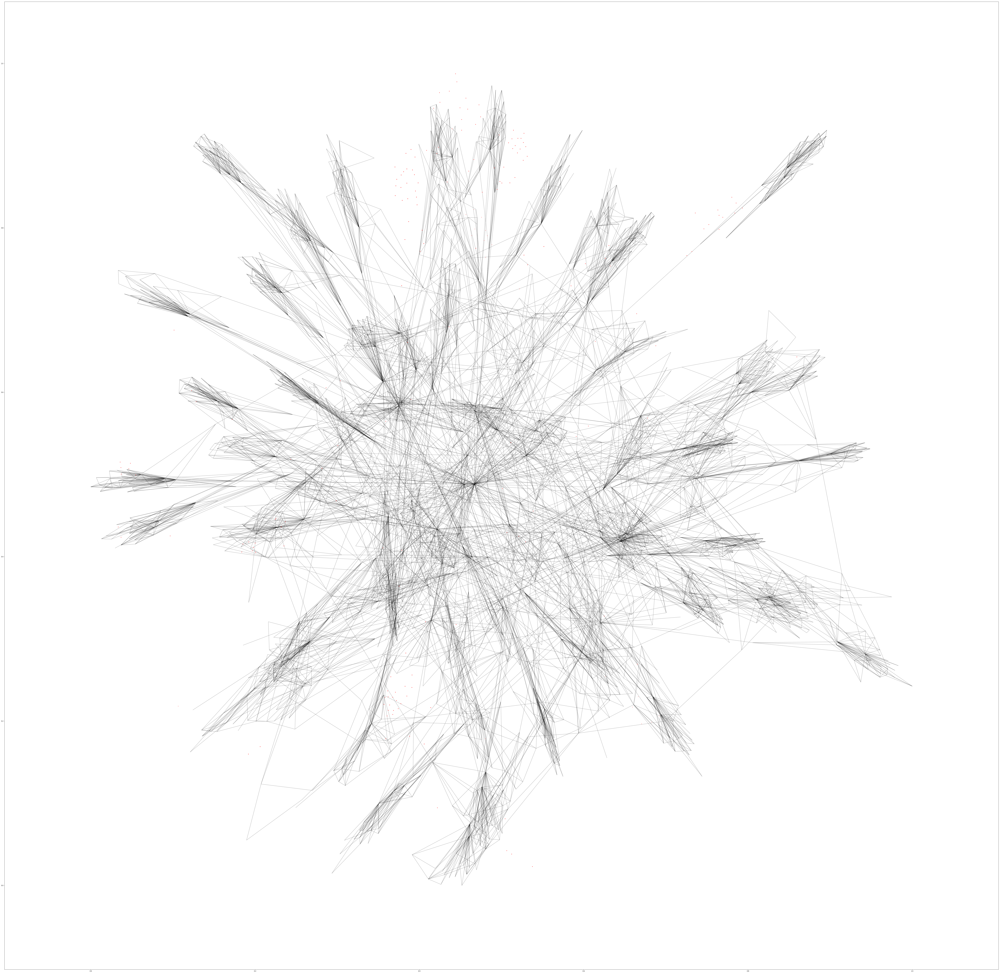

In [116]:
plt.figure(figsize = (120,120))

for idx,com in enumerate(communities):
    pos = nx.spring_layout(G)
    nx.draw_networkx_nodes(G,pos, nodelist=com,node_color='r',node_size=10, alpha=0.8, node_shape = shapes[idx], labels = map_labels)
nx.draw_networkx_edges(G,pos,width=1.0,alpha=0.5)
plt.show()



In [72]:
[len(communities) for i in communities]

[10, 10, 10, 10, 10, 10, 10, 10, 10, 10]

In [78]:
len(communities)

10

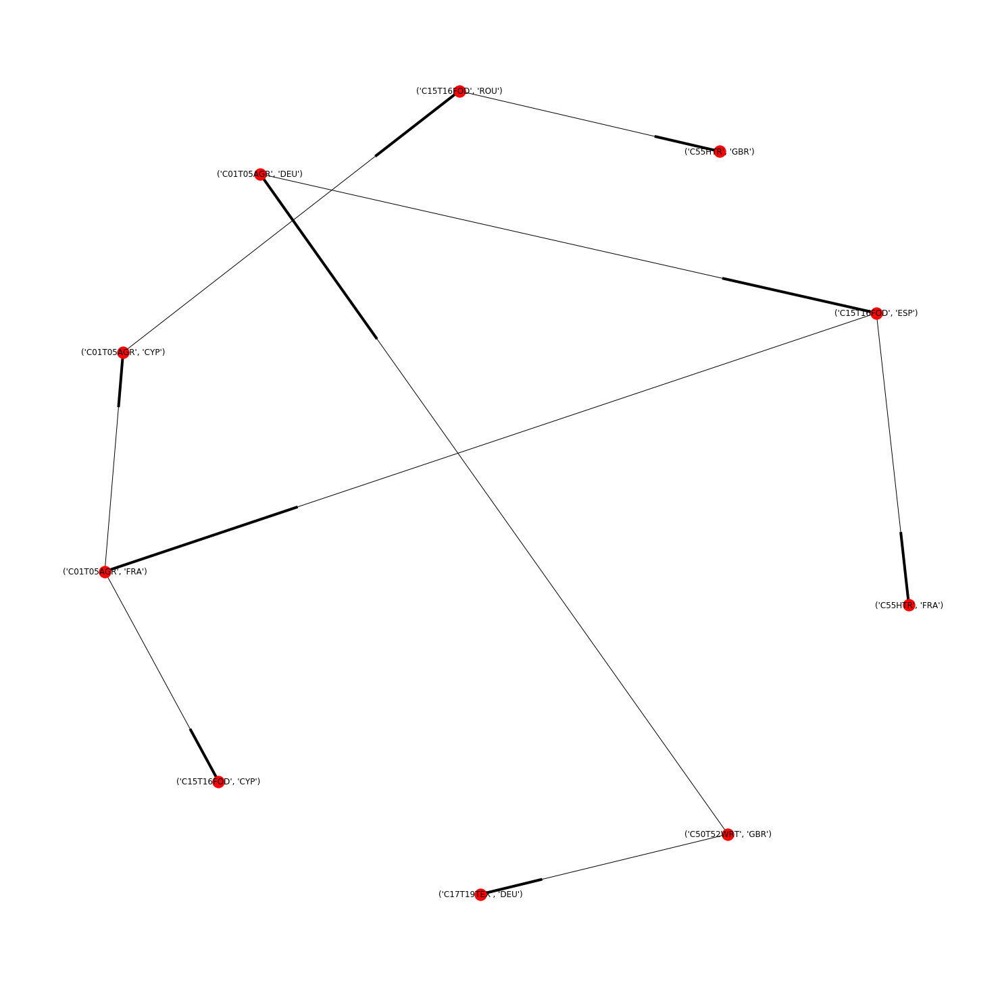

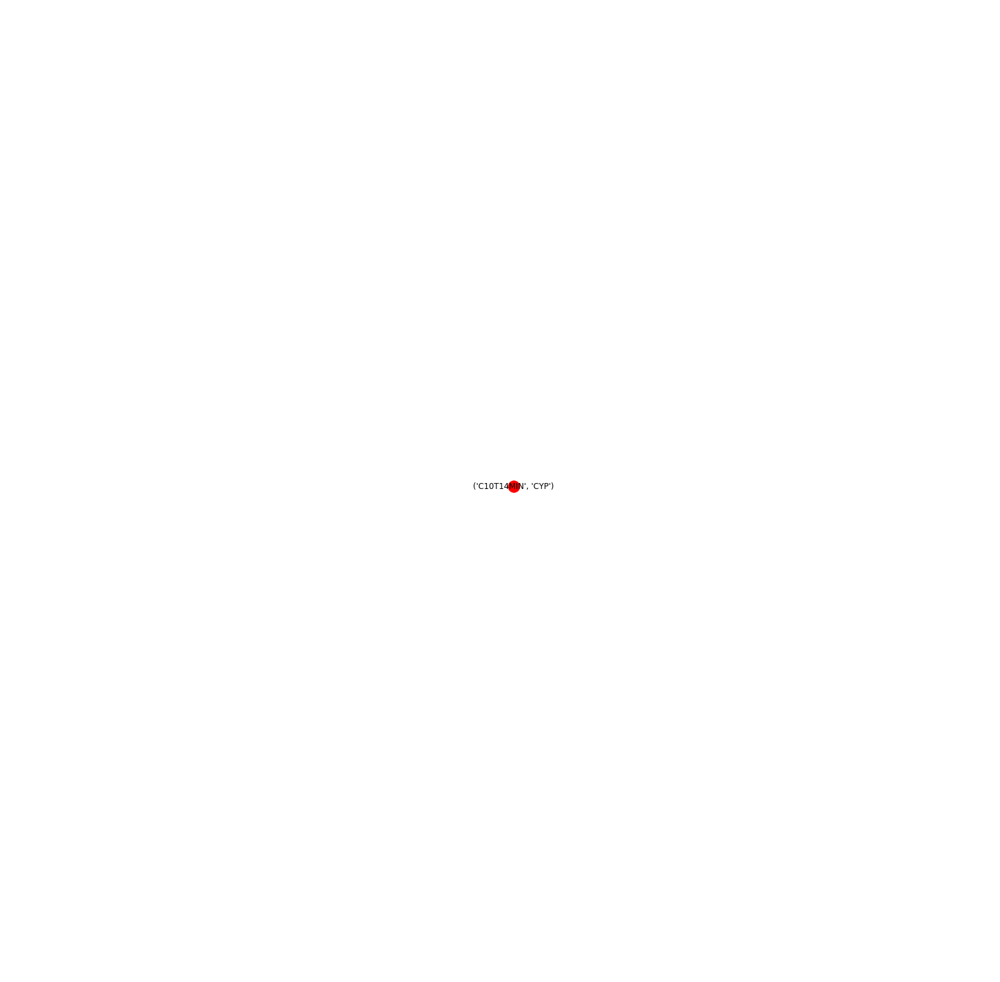

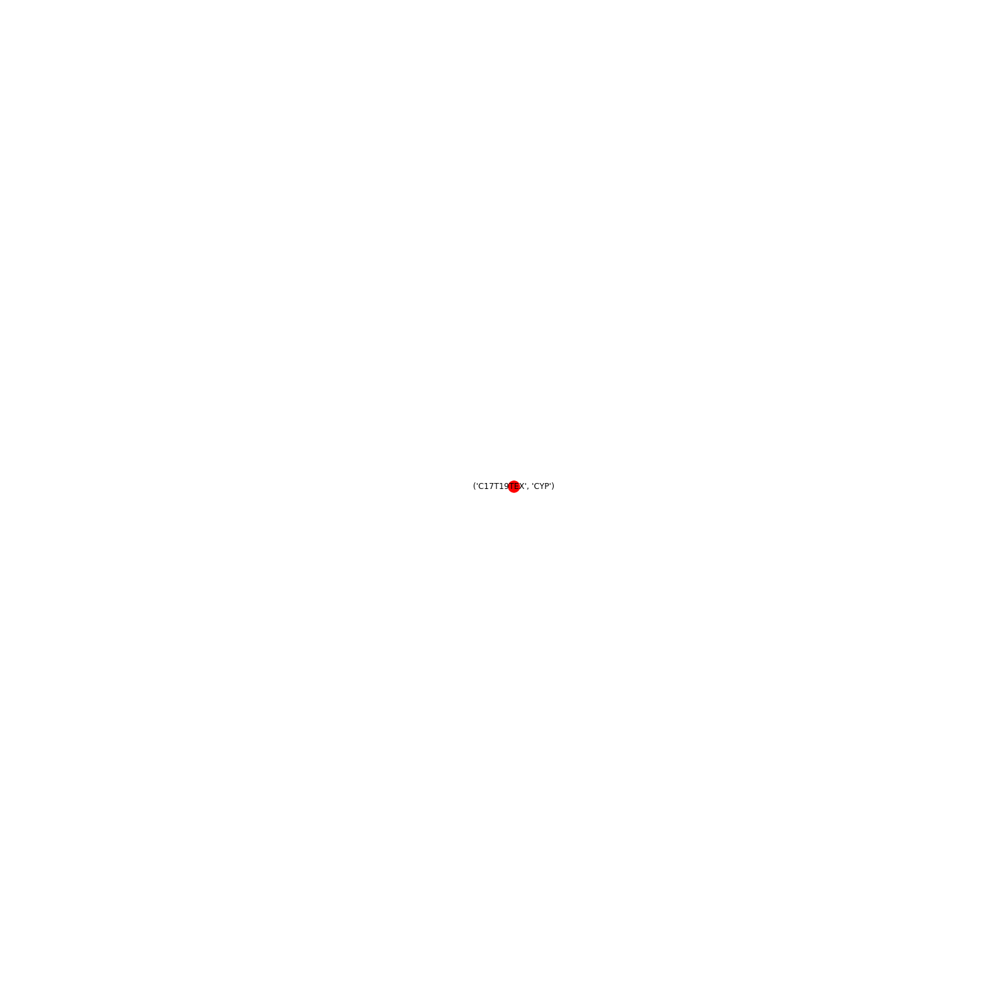

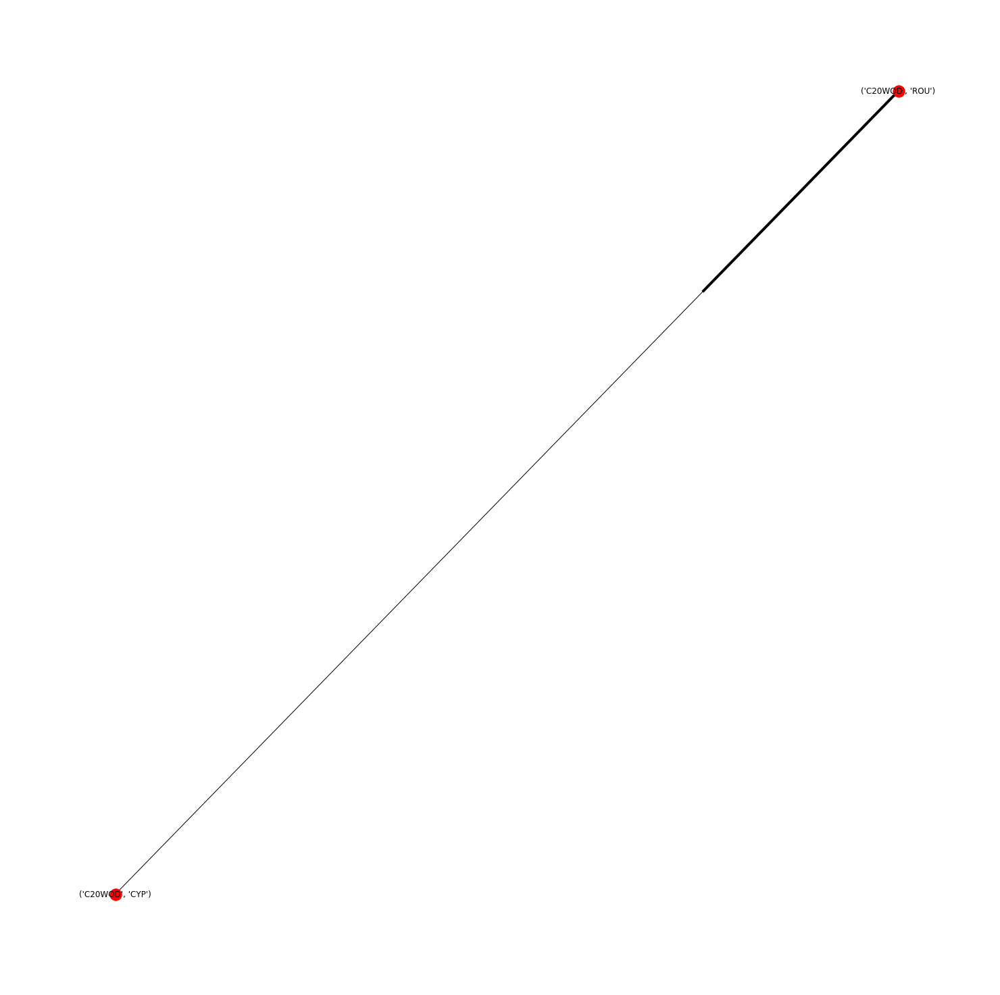

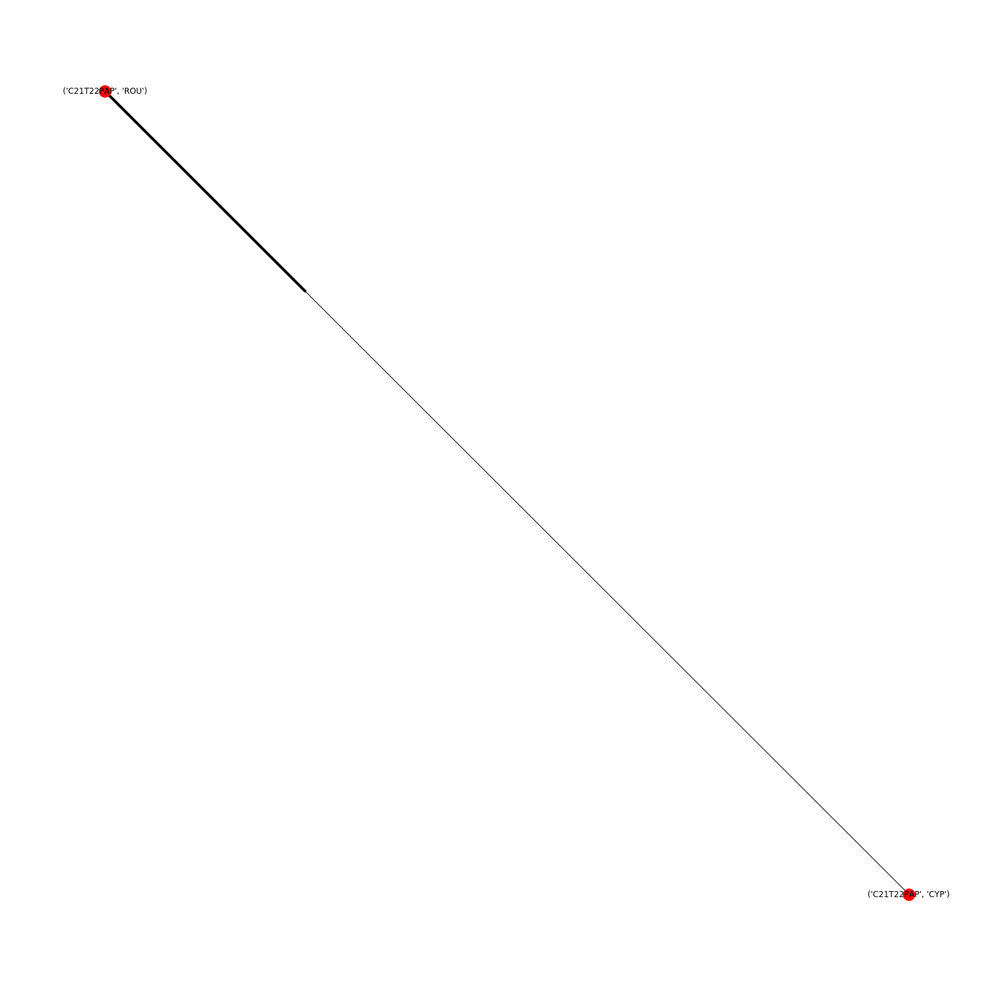

...

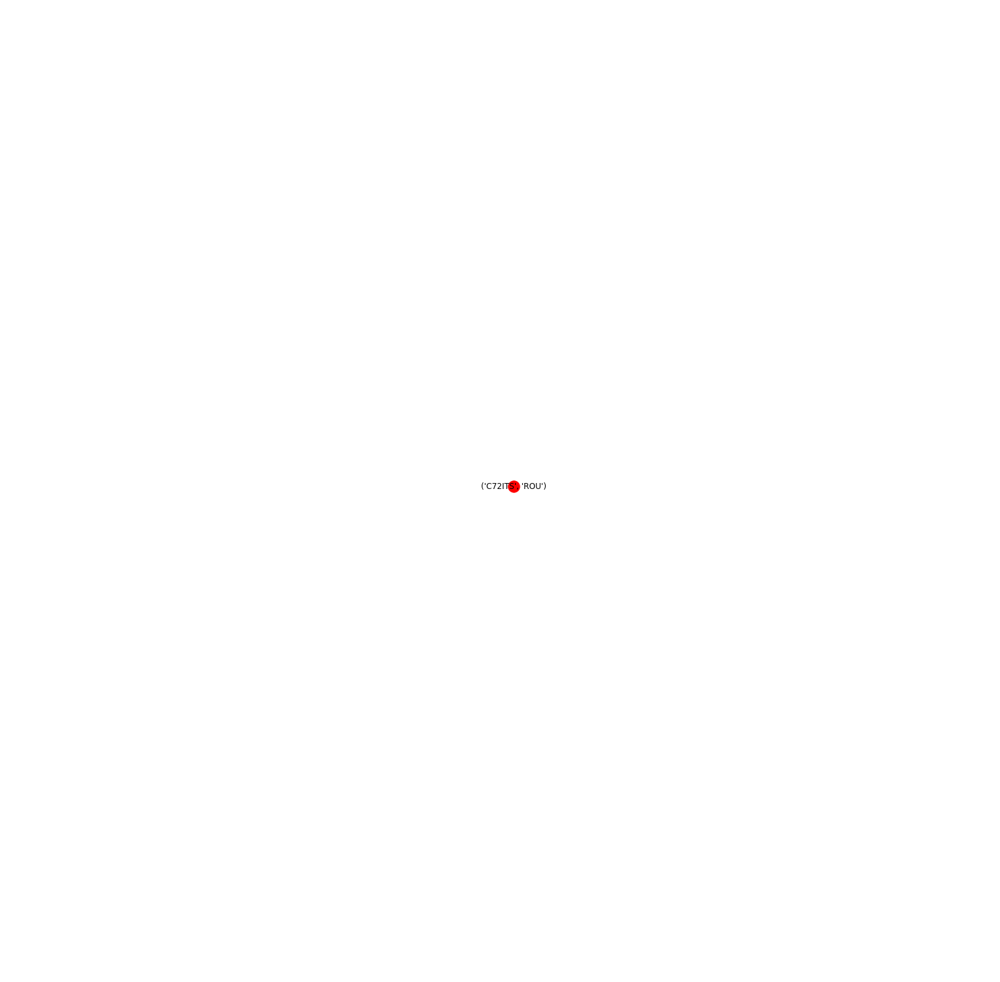

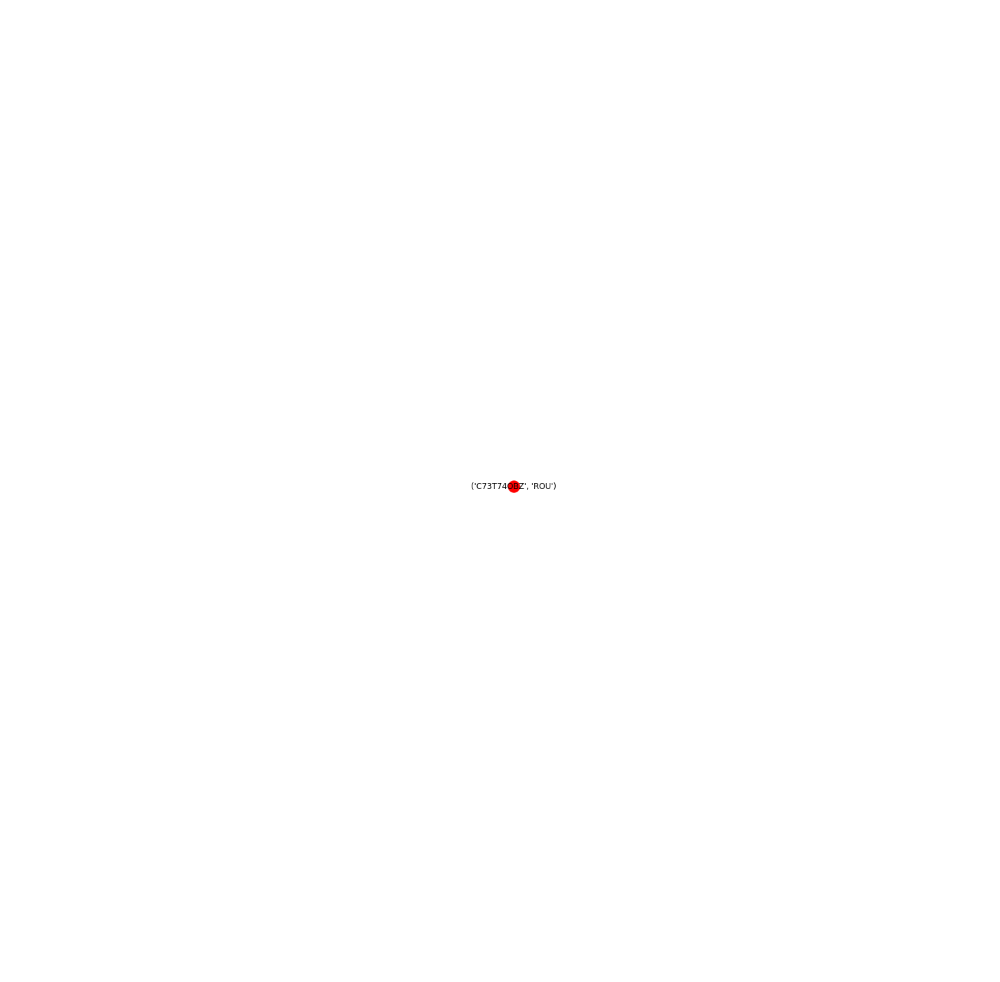

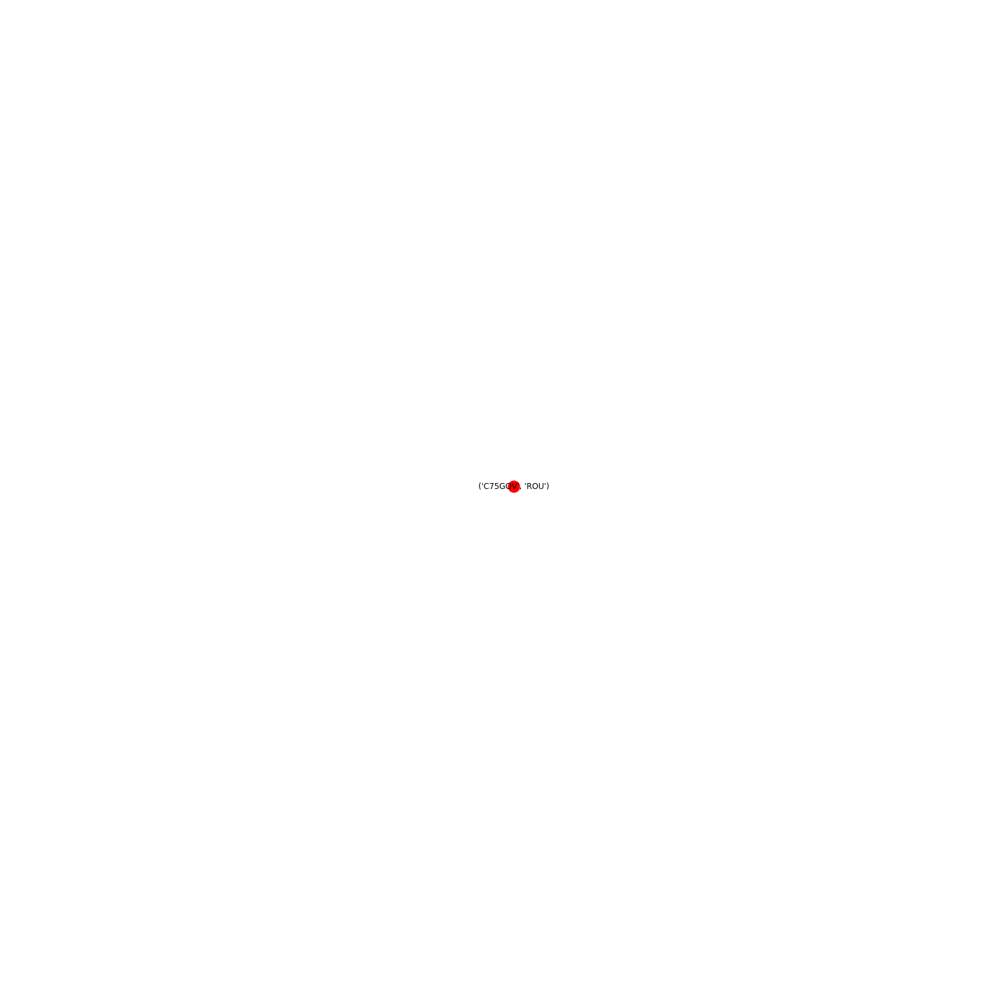

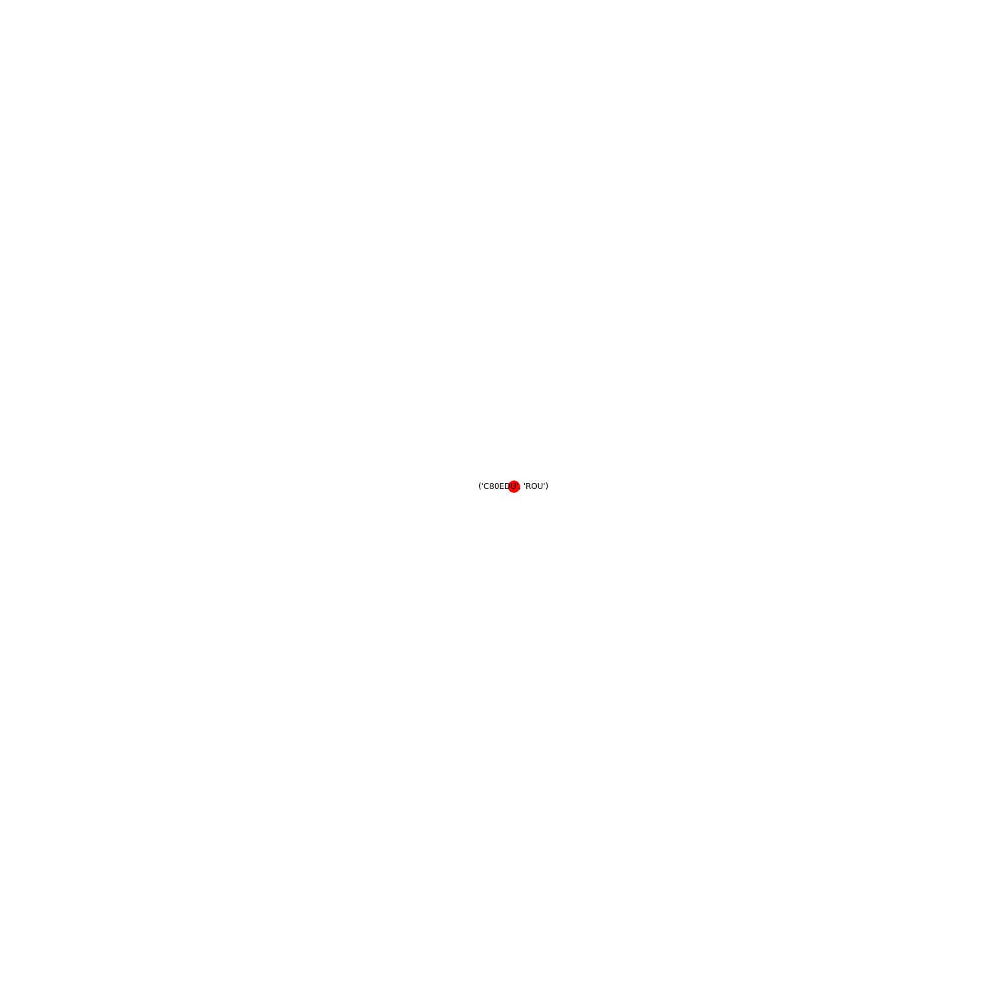

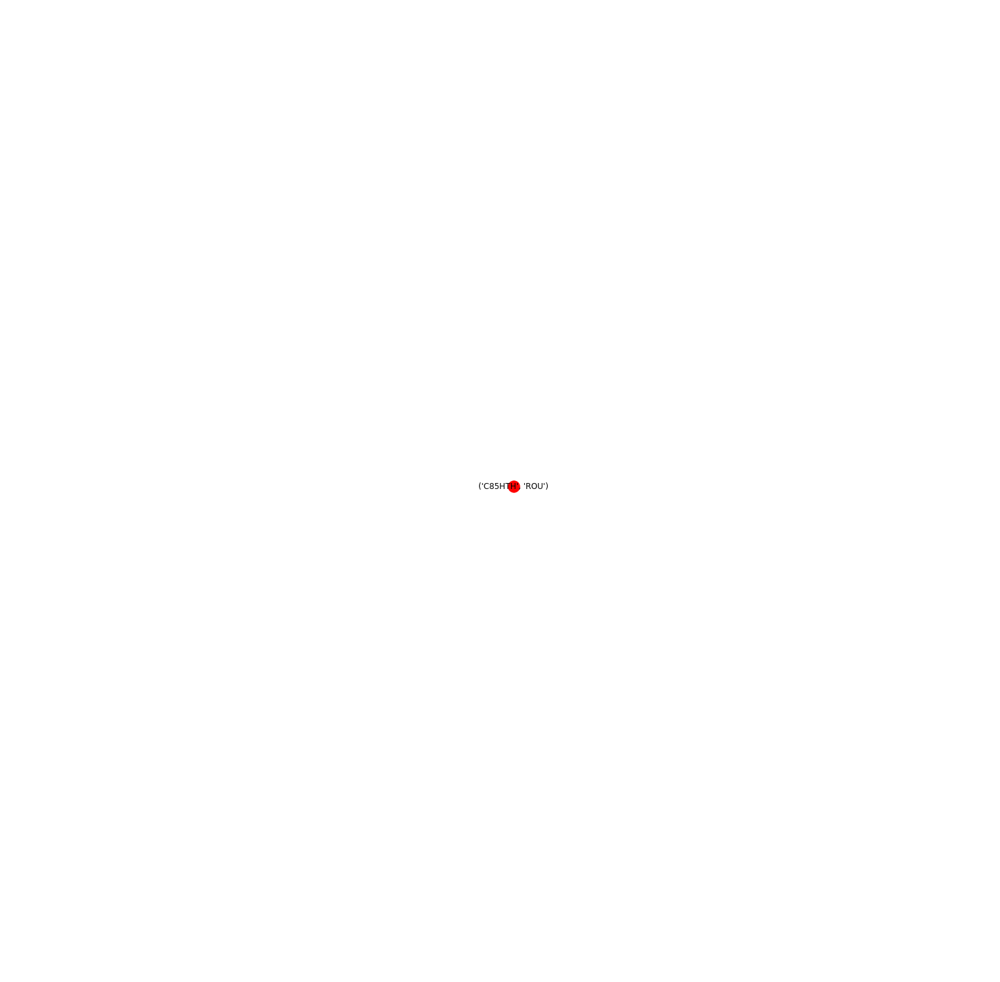

In [125]:
community_index = gn_partitions[0]

for i in range(len(community_index)):
    nodes_to_draw = []
    for n in list(community_index)[i]:
        nodes_to_draw.append(n)
    community1 = D.subgraph(nodes_to_draw)
    for node in community1.nodes():
        community1.node[node]['sector'] = sectors[node]
    labels_community=dict((n,(d['sector'], d['country'])) for n,d in community1.nodes(data=True))
    plt.figure(figsize = (20,20))
    nx.draw(community1, labels = labels_community)
    plt.show()

In [83]:
len(gn_partitions)

27

In [63]:
node_shape (string, optional (default=’o’)

SyntaxError: invalid syntax (<ipython-input-63-72bf46306113>, line 1)

In [4]:
weights = nx.get_edge_attributes(D, 'weight').values()
#color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066', 'ESP': '#FF33CC', 'ROU':'r', 'CYP':'#996600'} 

color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066' }
d = nx.degree(D)
shapes =  ['o', 'v', 'd',]


plt.figure(figsize = (120,120))

nx.draw(D, width = weights*20,
        node_color = [color_map[D.node[node]['country']] for node in D],
        node_size=[v * 100 for v in d.values()],
        node_shape = [s for s in shapes])


plt.title('Global Value Chains Sample Network')

france = mpatches.Patch(color = 'b', label = 'France')
britain =  mpatches.Patch(color = '#FF0099', label = 'Great Britain')
germany =  mpatches.Patch(color = '#660066', label = 'Germany')

plt.legend(handles=[france, britain, germany], prop={'size':200})
plt.show()

2

In [ ]:
##load from saved array
#np.save(file = 'gn_partition.npy',arr = list(gn_partition))
#gn_partition = np.load('gn_partition.npy')


In [13]:
gn_partition = list(gn_partition)
values = [gn_partition.get(node) for node in D.nodes()]
nx.draw_spring(D, cmap = plt.get_cmap('jet'), node_color = values, node_size=30, with_labels=False)

plt.show()

AttributeError: 'list' object has no attribute 'get'

In [20]:
list(gn_partition)[0]

KeyboardInterrupt: 

#### LIST OF Things to do

- for each community to look at the share of edges that connect 2 different countries
- calculate the average across all communities
    * repeat for different sectors
- loop across all years and create a plot indicating change of inter-country/inter-industry transaction

